Student name: Ku, Shih-Chieh<br>
Student ID: 8906826

# Lab 10 - Vanilla CNN and Fine-Tune VGG16 - for Dogs and Cats Classification

The goal of this lab is to pratice using pre-defined neural network model (VGG16), to classify the dogs and cats classification. The content would contain EDA, train models, evaluations on models, conclusion, and try to get insights from the pre-defined neural network model or data sets.

The data set contain only two types, cats and dogs with background or some real-life stuff.

In [4]:
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
import pandas as pd
import math
import os
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.utils import image_dataset_from_directory
from termcolor import colored
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import precision_recall_curve

train_folder = "./data/kaggle_dogs_vs_cats_small/train"
validation_folder = "./data/kaggle_dogs_vs_cats_small/validation"
test_folder = "./data/kaggle_dogs_vs_cats_small/test"

### EDA

Print total training data amount

In [ ]:
# The following is referenced from https://github.com/CSCN8010/CSCN8010/blob/main/dl_class_notebooks/05A_asirra_the_dogs_vs_cats_dataset.ipynb author by Professor Ran

import os, shutil, pathlib

original_dir = pathlib.Path("../data/kaggle_dogs_vs_cats/train")
new_base_dir = pathlib.Path("../data/kaggle_dogs_vs_cats_small")

def make_subset(subset_name, start_index, end_index):
    for category in ("cat", "dog"):
        dir = new_base_dir / subset_name / category
        os.makedirs(dir)
        fnames = [f"{category}.{i}.jpg" for i in range(start_index, end_index)]
        for fname in fnames:
            shutil.copyfile(src=original_dir / fname,
                            dst=dir / fname)

make_subset("train", start_index=0, end_index=1000)
make_subset("validation", start_index=1000, end_index=1500)
make_subset("test", start_index=1500, end_index=2500)

In [5]:
# The following is referenced from https://www.kaggle.com/code/nimapourmoradi/cats-vs-dogs-fullversion author by NIMA POURMORADI

dogs_amount = len(os.listdir(f'{train_folder}/dog'))
cats_amount = len(os.listdir(f'{train_folder}/cat'))
print(colored(f'Number of samples in train folder : {dogs_amount+cats_amount} (Dogs and cats)', 'blue', attrs=['bold']))

Number of samples in train folder : 2000 (Dogs and cats)


Print total training data amount for each class

In [6]:
# The following is referenced from https://www.kaggle.com/code/nimapourmoradi/cats-vs-dogs-fullversion author by NIMA POURMORADI

print(colored(f'Number of cats : {dogs_amount}', 'blue', attrs=['bold']))
print(colored(f'Number of dogs : {cats_amount}', 'blue', attrs=['bold']))
total_count = [dogs_amount, cats_amount]

Number of cats : 1000
Number of dogs : 1000


Print comparison

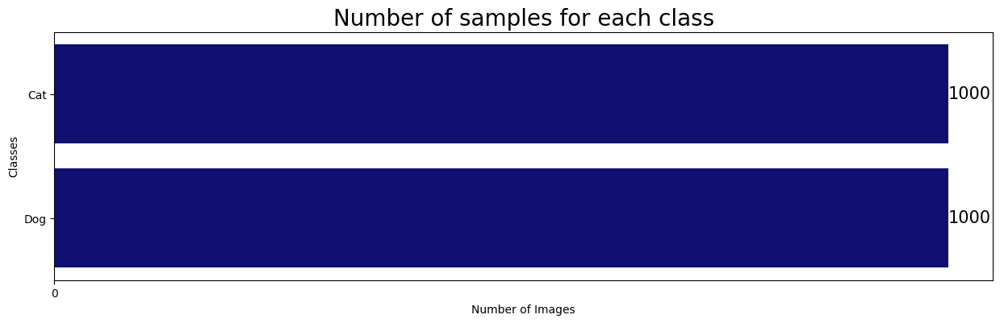

In [7]:
# The following is referenced from https://www.kaggle.com/code/nimapourmoradi/cats-vs-dogs-fullversion author by NIMA POURMORADI

plt.figure(figsize=(15, 4))
ax = sns.barplot(x=total_count, y=['Cat', 'Dog'], orient='h', color='navy')
ax.set_xticks(np.arange(0, 2000, 2000))
ax.set_xlabel('Number of Images')
ax.set_ylabel('Classes')
ax.set_title('Number of samples for each class', fontsize=20)
for i, p in enumerate(ax.patches) :
    ax.text(p.get_width(), p.get_y() + p.get_height() / 2.,
            '{}'.format(total_count[i]), 
             va="center", fontsize=15)

In [8]:
fig = px.pie(
    values=total_count,
    names=['Cats %', 'Dogs %'],
    title="Percentage of dataset per label",
)
fig.show()

Print 36 images for each class

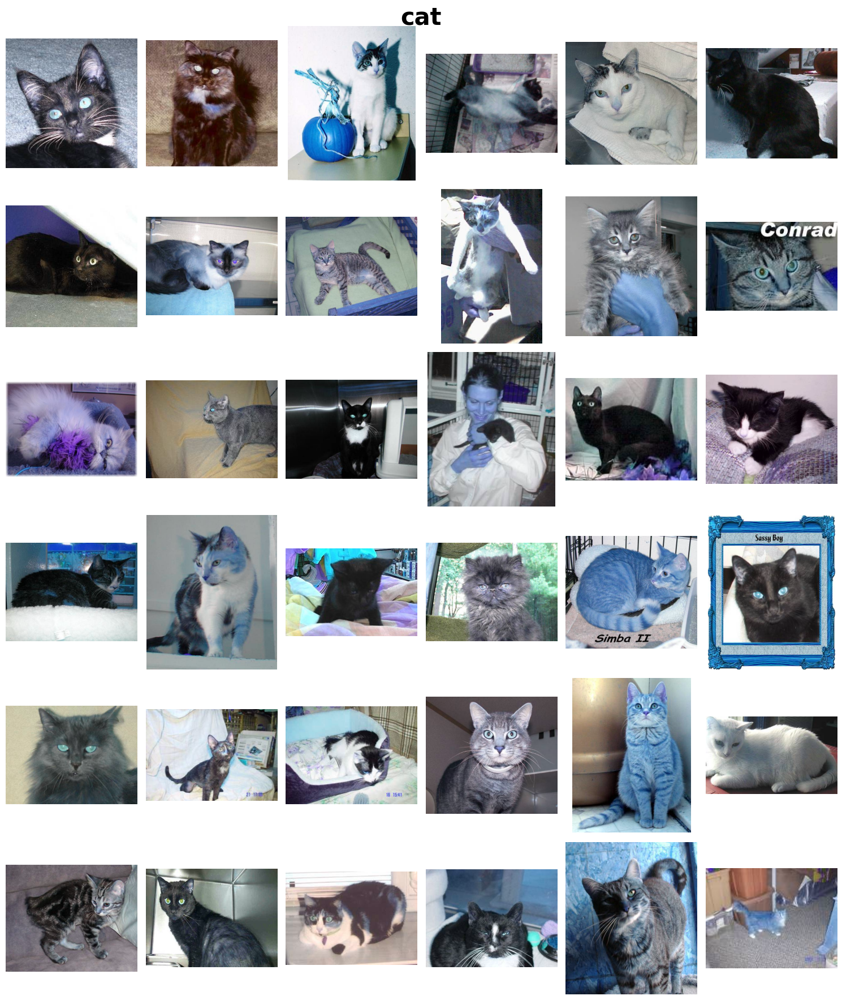

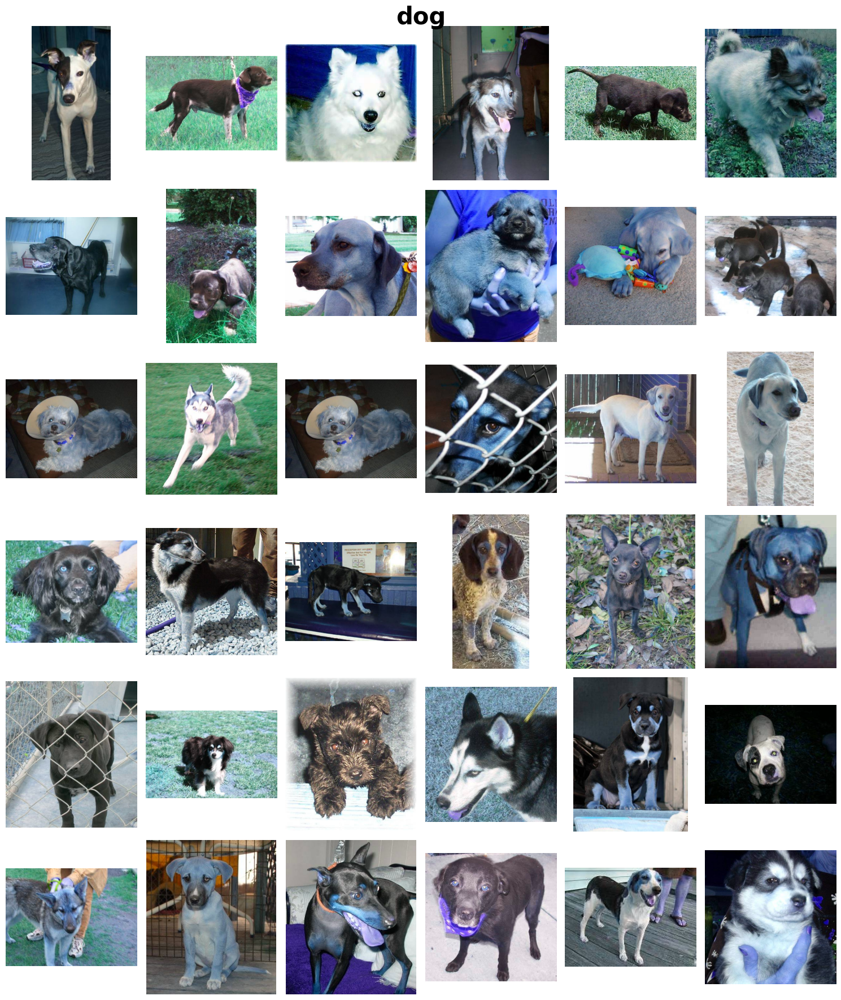

In [282]:
# The following is referenced from https://www.kaggle.com/code/nimapourmoradi/cats-vs-dogs-fullversion author by NIMA POURMORADI

def plot_image(images, title, size) :
    plt.figure(figsize=(15, 18))
    for i, val in enumerate(images) :
        plt.subplot(size, size, i+1)
        img = cv2.imread(f'{train_folder}/{title}/{title}.{val}.jpg')
        plt.imshow(img)
        plt.axis('off')
    plt.suptitle(title, fontsize=30, fontweight='bold')
    plt.tight_layout()
    plt.show()
        
# Setting the random seed for reproducibility
np.random.seed(42)

for classes in ['cat', 'dog'] :
    random_image = np.random.choice(1000, 36)
    plot_image(random_image, classes, 6)

> According to the above observations, since I manually split the data into balanced groups (1000 cats vs. 1000 dogs), they comprise half of the entire training dataset. <br><br>
> Furthermore, I randomly printed out 36 images for each class. At first glance, there is no obvious difference between dogs and cats because these images are real-life images rather than MNIST images that follow a specified standard. In contrast, these dogs and cats have different backgrounds, angles, directions, and shapes, making it difficult to find a logical template to distinguish between them. <br><br>
> However, the only feature I can tell you is really different is that the oral structure is elongated for dogs, while it's shorter and flatter for cats. In conclusion, based on this observation, I can better distinguish them.


### Train two networks

Define a Neural Network of my choice

In [183]:
train_dataset = image_dataset_from_directory(
    train_folder,
    image_size=(180, 180),
    batch_size=32)

validation_dataset = image_dataset_from_directory(
    validation_folder,
    image_size=(180, 180),
    batch_size=32)

test_dataset = image_dataset_from_directory(
    test_folder,
    image_size=(180, 180),
    batch_size=32,
    shuffle=False)

Found 2000 files belonging to 2 classes.
Found 1000 files belonging to 2 classes.
Found 2000 files belonging to 2 classes.


In [46]:
my_defined_model = keras.Sequential([
    layers.Dense(256, activation="relu"),
    layers.Dense(512, activation="relu"),
    layers.Dense(10, activation="softmax")
])

In [50]:
inputs = keras.Input(shape=(180, 180, 3))
x = layers.Rescaling(1./255)(inputs)
x = layers.Conv2D(filters=32, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=64, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=128, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2)(x)
x = layers.Conv2D(filters=256, kernel_size=3, activation="relu")(x)
x = layers.Flatten()(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
my_defined_model = keras.Model(inputs=inputs, outputs=outputs)

In [53]:
my_defined_model.compile(loss="binary_crossentropy",
              optimizer="rmsprop",
              metrics=["accuracy"])

callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="./models/convnet_from_scratch.keras",
        save_best_only=True,
        monitor="val_loss")
]


In [61]:
history_my_defined_model = my_defined_model.fit(
    train_dataset,
    epochs=30,
    validation_data=validation_dataset,
    callbacks=callbacks)

Epoch 1/30


63/63 [==============================] - 24s 372ms/step - loss: 0.0342 - accuracy: 0.9890 - val_loss: 1.9973 - val_accuracy: 0.7410
Epoch 2/30
63/63 [==============================] - 23s 359ms/step - loss: 0.0434 - accuracy: 0.9865 - val_loss: 2.0882 - val_accuracy: 0.7090
Epoch 3/30
63/63 [==============================] - 22s 356ms/step - loss: 0.0436 - accuracy: 0.9905 - val_loss: 2.4127 - val_accuracy: 0.7350
Epoch 4/30
63/63 [==============================] - 23s 367ms/step - loss: 0.0462 - accuracy: 0.9885 - val_loss: 2.5090 - val_accuracy: 0.7170
Epoch 5/30
63/63 [==============================] - 23s 365ms/step - loss: 0.0575 - accuracy: 0.9815 - val_loss: 2.6776 - val_accuracy: 0.7140
Epoch 6/30
63/63 [==============================] - 23s 367ms/step - loss: 0.0299 - accuracy: 0.9935 - val_loss: 2.2626 - val_accuracy: 0.7080
Epoch 7/30
63/63 [==============================] - 23s 358ms/step - loss: 0.0361 - accuracy: 0.9910 - val_loss: 2.0502 - val_accuracy: 0.7380
Epoch 8/30

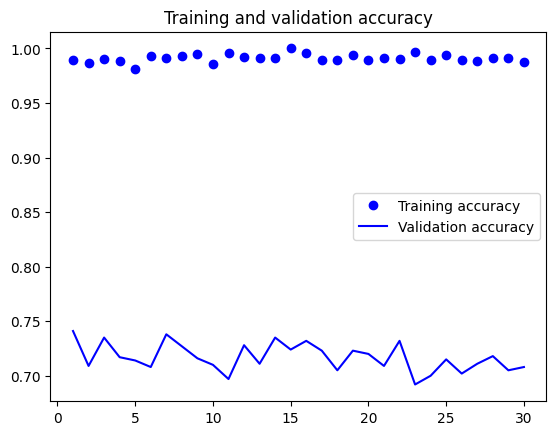

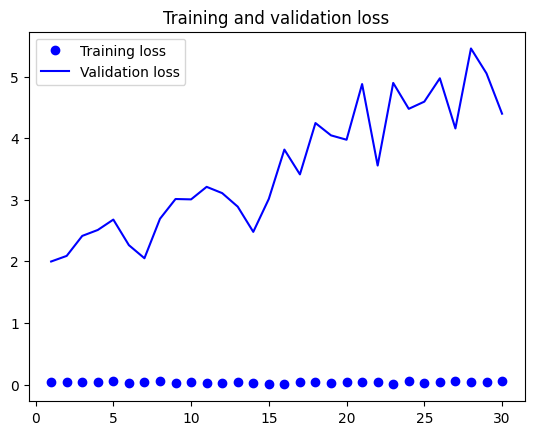

In [62]:
acc = history_my_defined_model.history["accuracy"]
val_acc = history_my_defined_model.history["val_accuracy"]
loss = history_my_defined_model.history["loss"]
val_loss = history_my_defined_model.history["val_loss"]
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, "bo", label="Training accuracy")
plt.plot(epochs, val_acc, "b", label="Validation accuracy")
plt.title("Training and validation accuracy")
plt.legend()
plt.figure()
plt.plot(epochs, loss, "bo", label="Training loss")
plt.plot(epochs, val_loss, "b", label="Validation loss")
plt.title("Training and validation loss")
plt.legend()
plt.show()

> According to the above graph, it indicates that the model consistently performs well on the training data but shows relatively inefficient performance on validation data. Regarding accuracy, from epoch 1 to epoch 30, it maintains approximately 93% to 97% accuracy. Even more surprising is that it maintains high efficiency performance from epoch 1. On the contray, the accuracy on the validation data is around 70% to 75%, compared to the accuracy on the training data, there is obvious gap between them. <br><br>
> For the loss part, the loss has been continuously increasing since epoch 2, despite occasional decreases in between (7, 14, etc.). However, the overall trend is still upward. It's hard not to feel like the overfitting from epoch 2.

Fine-Tune VGG16 (pre-trained on imagenet). Make sure to use validation to test for over-fitting.

In [55]:
conv_base = keras.applications.vgg16.VGG16(
    weights="imagenet",
    include_top=False,
    input_shape=(180, 180, 3))

conv_base.trainable = True
for layer in conv_base.layers[:-4]:
    layer.trainable = False

In [8]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 180, 180, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 180, 180, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 90, 90, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 90, 90, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 90, 90, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 45, 45, 128)       0     

In [58]:
# The following is referenced from https://github.com/CSCN8010/CSCN8010/blob/main/dl_class_notebooks/05D_fine_tuning_vgg16.ipynb author by Professor Ran

data_augmentation = keras.Sequential(
    [
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(0.1),
        layers.RandomZoom(0.2),
    ]
) 

inputs = keras.Input(shape=(180, 180, 3))
x = data_augmentation(inputs)
x = keras.applications.vgg16.preprocess_input(x)
x = conv_base(x)
x = layers.Flatten()(x)
x = layers.Dense(256)(x)
# x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model = keras.Model(inputs, outputs)

In [57]:
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 sequential_3 (Sequential)   (None, 180, 180, 3)       0         
                                                                 
 tf.__operators__.getitem_1   (None, 180, 180, 3)      0         
 (SlicingOpLambda)                                               
                                                                 
 tf.nn.bias_add_1 (TFOpLambd  (None, 180, 180, 3)      0         
 a)                                                              
                                                                 
 vgg16 (Functional)          (None, 5, 5, 512)         14714688  
                                                                 
 flatten_2 (Flatten)         (None, 12800)             0   

In [59]:
# The following is referenced from https://github.com/CSCN8010/CSCN8010/blob/main/dl_class_notebooks/05D_fine_tuning_vgg16.ipynb author by Professor Ran

model.compile(loss="binary_crossentropy",
              optimizer=keras.optimizers.RMSprop(learning_rate=1e-5),
              metrics=["accuracy"])

callbacks_vgg = [
    keras.callbacks.ModelCheckpoint(
        filepath="./models/fine_tuning.keras",
        save_best_only=True,
        monitor="val_loss")
]
history = model.fit(
    train_dataset,
    epochs=30,
    validation_data=validation_dataset,
    callbacks=callbacks_vgg)

Epoch 1/30
63/63 [==============================] - 101s 2s/step - loss: 2.1723 - accuracy: 0.7955 - val_loss: 0.5598 - val_accuracy: 0.9310
Epoch 2/30
63/63 [==============================] - 104s 2s/step - loss: 0.5355 - accuracy: 0.9230 - val_loss: 0.4120 - val_accuracy: 0.9470
Epoch 3/30
63/63 [==============================] - 107s 2s/step - loss: 0.3236 - accuracy: 0.9485 - val_loss: 0.3559 - val_accuracy: 0.9550
Epoch 4/30
63/63 [==============================] - 109s 2s/step - loss: 0.2791 - accuracy: 0.9480 - val_loss: 0.2826 - val_accuracy: 0.9580
Epoch 5/30
63/63 [==============================] - 107s 2s/step - loss: 0.2021 - accuracy: 0.9580 - val_loss: 0.2251 - val_accuracy: 0.9670
Epoch 6/30
63/63 [==============================] - 105s 2s/step - loss: 0.1531 - accuracy: 0.9680 - val_loss: 0.2228 - val_accuracy: 0.9610
Epoch 7/30
63/63 [==============================] - 106s 2s/step - loss: 0.1261 - accuracy: 0.9710 - val_loss: 0.2172 - val_accuracy: 0.9620
Epoch 8/30
63

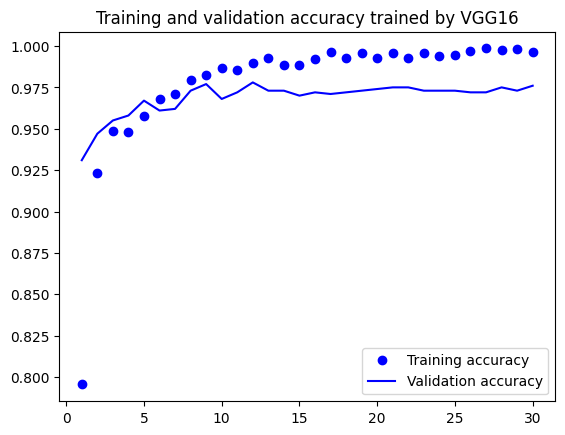

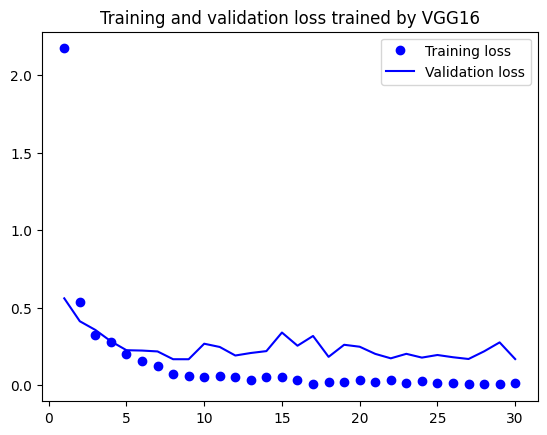

In [64]:
# The following is referenced from https://github.com/CSCN8010/CSCN8010/blob/main/dl_class_notebooks/05D_fine_tuning_vgg16.ipynb author by Professor Ran

acc = history.history["accuracy"]
val_acc = history.history["val_accuracy"]
loss = history.history["loss"]
val_loss = history.history["val_loss"]
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, "bo", label="Training accuracy")
plt.plot(epochs, val_acc, "b", label="Validation accuracy")
plt.title("Training and validation accuracy trained by VGG16")
plt.legend()
plt.figure()
plt.plot(epochs, loss, "bo", label="Training loss")
plt.plot(epochs, val_loss, "b", label="Validation loss")
plt.title("Training and validation loss trained by VGG16")
plt.legend()
plt.show()

> According to the validation loss and accuracy graphics, I found that this VGG16 model showed less overfitting as the number of epochs increased. In contrast to the previous model we developed in lab 8 and 9, where the validation loss tended to increase after reaching its smallest value, indicating overfitting to the training data. <br><br>
> However, for this model, although when the validation loss reaches relatively smaller values then goes up to a higher value, go to the next epoch, it seems that the validation loss would decrease for lower values. <br><br>
> Compared to the model defined by myself, this model (VGG16) showed the great performance.

### Explore the relative performance of the models

In [128]:
best_from_my_defined_model = keras.models.load_model("./models/convnet_from_scratch.keras")
best_from_VGG_16_model = keras.models.load_model("./models/fine_tuning.keras")


In [187]:
test_loss_my, test_acc_my = best_from_my_defined_model.evaluate(test_dataset)
test_loss_VGG16, test_acc_VGG16 = best_from_VGG_16_model.evaluate(test_dataset)

63/63 [==============================] - 46s 733ms/step - loss: 0.2083 - accuracy: 0.9710


Accuracy

In [209]:
print(
    f"The accuracy of the VGG16 predicted on test dataset is {round(test_acc_VGG16*100,2)}%"
)

print(
    f"The accuracy of the my defined model predicted on test dataset is {round(test_acc_my*100,2)}%"
)

The accuracy of the VGG16 predicted on test dataset is 97.1%
The accuracy of the my defined model predicted on test dataset is 70.4%


In [188]:
y_predict_my =  best_from_my_defined_model.predict(test_dataset)
y_predict_VGG16 = best_from_VGG_16_model.predict(test_dataset)


 1/63 [..............................] - ETA: 5s

63/63 [==============================] - 47s 750ms/step


Confusion Matrix of VGG16

In [212]:

ground_truth_VGG16 = []
for images, labels in test_dataset:
    ground_truth_VGG16.extend(labels.numpy())

y_true_VGG16 = np.concatenate([y for x, y in test_dataset], axis=0)
y_pred_labels_VGG16 = [0 if pred < 0.5 else 1 for pred in y_predict_VGG16]
cm_VGG16 = confusion_matrix(ground_truth_VGG16, y_pred_labels_VGG16)
tn_VGG16, fp_VGG16, fn_VGG16, tp_VGG16 = cm_VGG16.ravel()

tn_VGG16, fp_VGG16, fn_VGG16, tp_VGG16

print('The confusion matrix of VGG16 model predicted on the test dataset is: ')
df_cm_VGG16 = pd.DataFrame(
    {
        "Actual Values: Positive": [tp_VGG16, fp_VGG16],
        "Actual Values: Negative": [fn_VGG16, tn_VGG16],
    }
)

df_cm_VGG16.style.relabel_index(
    ["Predicted Values: Positive", "Predicted Values: Negative"], axis=0
)

The confusion matrix of VGG 16 model predicted on the test dataset is: 


,Actual Values: Positive,Actual Values: Negative
Predicted Values: Positive,973,27
Predicted Values: Negative,31,969


Confusion Matrix of my defined model

In [213]:
ground_truth_my = []
for images, labels in test_dataset:
    ground_truth_my.extend(labels.numpy())

y_true_my = np.concatenate([y for x, y in test_dataset], axis=0)
y_pred_labels_my = [0 if pred < 0.5 else 1 for pred in y_predict_my]
cm_my = confusion_matrix(ground_truth_my, y_pred_labels_my)
tn_my, fp_my, fn_my, tp_my = cm_my.ravel()

print('The confusion matrix of my defined model predicted on the test dataset is: ')

df_cm_my = pd.DataFrame(
    {
        "Actual Values: Positive": [tp_my, fp_my],
        "Actual Values: Negative": [fn_my, tn_my],
    }
)

df_cm_my.style.relabel_index(
    ["Predicted Values: Positive", "Predicted Values: Negative"], axis=0
)

The confusion matrix of my defined model predicted on the test dataset is: 


,Actual Values: Positive,Actual Values: Negative
Predicted Values: Positive,686,314
Predicted Values: Negative,278,722


Precision, recall, f1-score of VGG16 model predicted on the test dataset:

In [214]:
print(classification_report(ground_truth_VGG16, y_pred_labels_VGG16))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97      1000
           1       0.97      0.97      0.97      1000

    accuracy                           0.97      2000
   macro avg       0.97      0.97      0.97      2000
weighted avg       0.97      0.97      0.97      2000



Precision, recall, f1-score of my defined model predicted on the test dataset:

In [215]:
print(classification_report(ground_truth_my, y_pred_labels_my))

              precision    recall  f1-score   support

           0       0.70      0.72      0.71      1000
           1       0.71      0.69      0.70      1000

    accuracy                           0.70      2000
   macro avg       0.70      0.70      0.70      2000
weighted avg       0.70      0.70      0.70      2000



Precision-recall curve of VGG16 model predicted on the test dataset

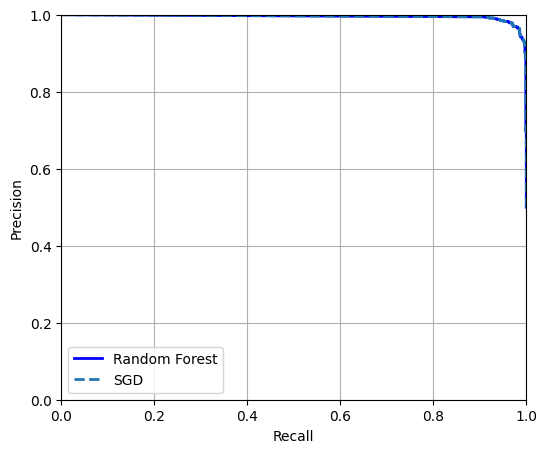

In [225]:
precision, recall, thresholds = precision_recall_curve(ground_truth_VGG16, y_predict_VGG16)

plt.figure(figsize=(6, 5))

plt.plot(recall, precision, "b-", linewidth=2,
         label="Random Forest")
plt.plot(recall, precision, "--", linewidth=2, label="SGD")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.axis([0, 1, 0, 1])
plt.grid()
plt.legend(loc="lower left")

plt.show()


Precision-recall curve of my defined model predicted on the test dataset

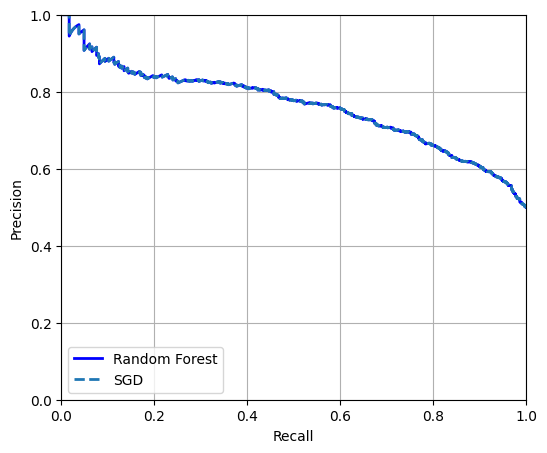

In [227]:
precision, recall, thresholds = precision_recall_curve(ground_truth_my, y_predict_my)

plt.figure(figsize=(6, 5))

plt.plot(recall, precision, "b-", linewidth=2,
         label="Random Forest")
plt.plot(recall, precision, "--", linewidth=2, label="SGD")
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.axis([0, 1, 0, 1])
plt.grid()
plt.legend(loc="lower left")

plt.show()


In [240]:
(ground_truth_my != y_predict_my).shape

(2000, 2000)

In [245]:
y_predict_my

array([[0.03048192],
       [0.9686723 ],
       [0.06859262],
       ...,
       [0.78584486],
       [0.6641568 ],
       [0.33093837]], dtype=float32)

In [236]:
len(y_predict_my)

2000

In [249]:
def find_unequal_indexes(list1, list2):
    unequal_indices = []
    min_length = min(len(list1), len(list2))
    
    for i in range(min_length):
        if list1[i] != list2[i]:
            unequal_indices.append(i+1)
            
    for i in range(min_length, max(len(list1), len(list2))):
        unequal_indices.append(i+1)
    
    return unequal_indices


unequal_indices_VGG16 = find_unequal_indexes(y_true_VGG16, y_pred_labels_VGG16)
unequal_indices_my = find_unequal_indexes(y_true_my, y_pred_labels_my)
print("Indices with unequal values:", unequal_indices_VGG16)


Indices with unequal values: [8, 33, 48, 76, 85, 117, 120, 173, 248, 305, 371, 377, 402, 413, 510, 530, 541, 562, 565, 631, 660, 686, 703, 753, 845, 856, 867, 901, 916, 958, 977, 1010, 1018, 1064, 1069, 1102, 1123, 1164, 1208, 1237, 1246, 1297, 1316, 1365, 1385, 1396, 1486, 1504, 1519, 1600, 1691, 1765, 1772, 1851, 1863, 1898, 1909, 1923]


### Explore specific examples in which the model failed to predict correctly

The image of both class on failed predictions of VGG16 model

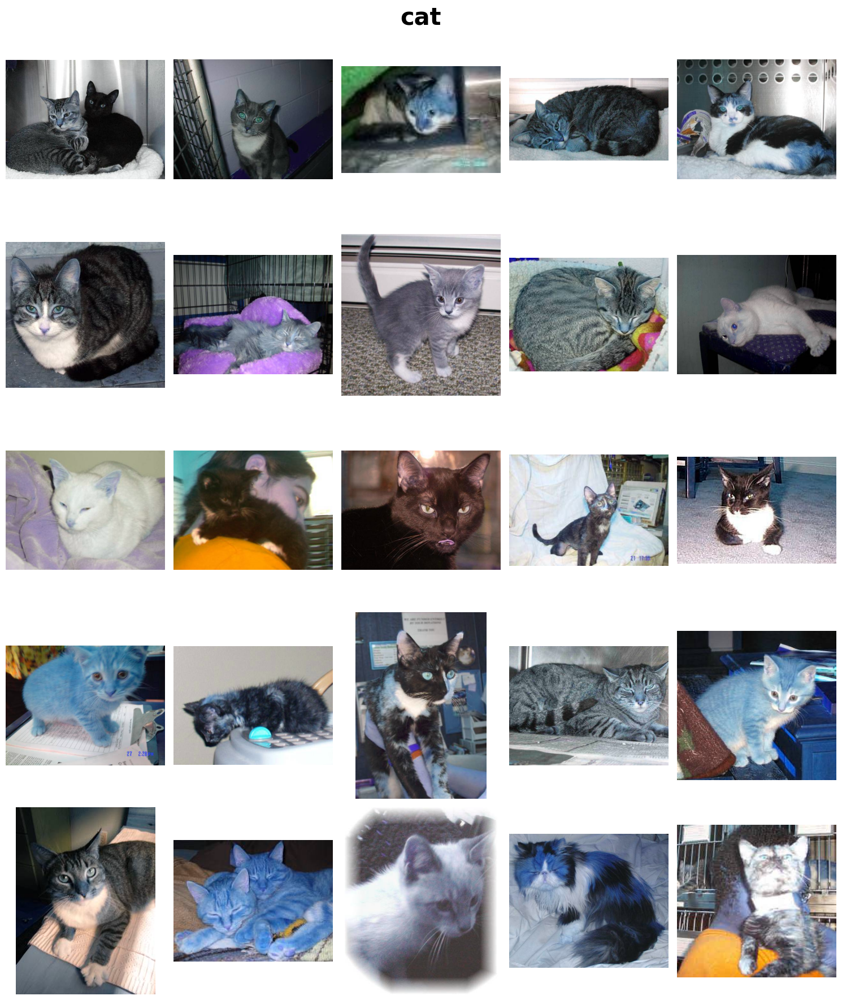

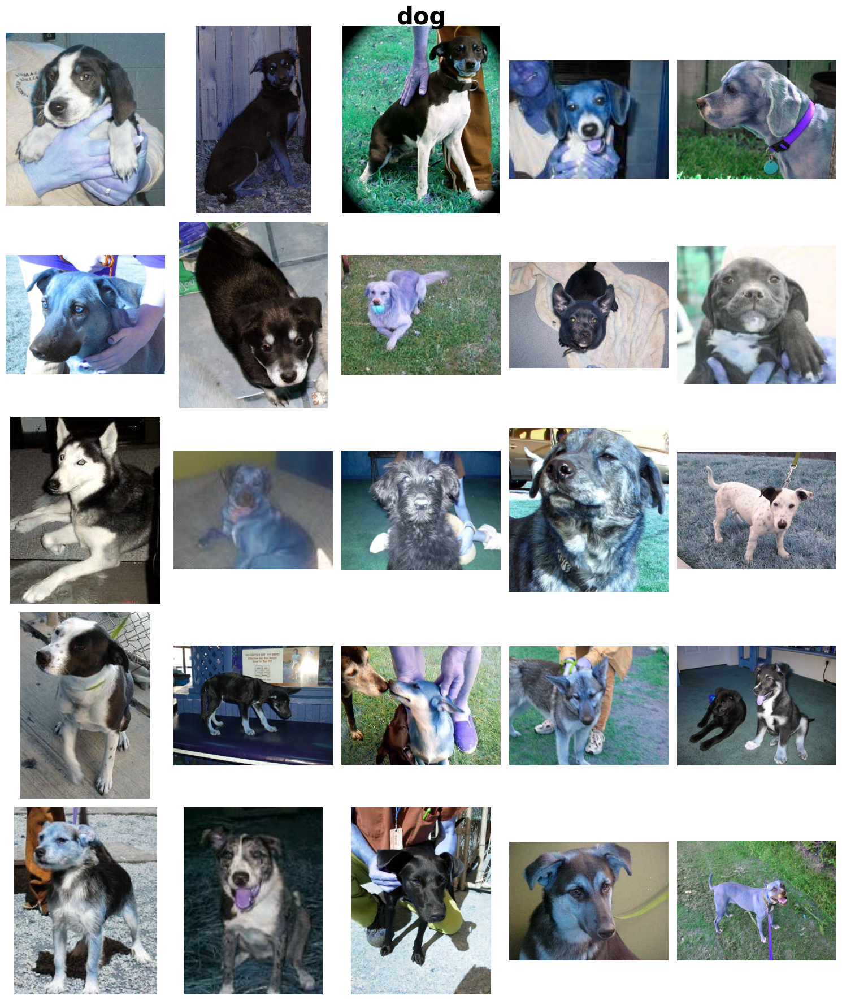

In [285]:
for classes in ['cat', 'dog'] :
    if classes == 'cat':
        images = [i for i in unequal_indices_VGG16 if i <= 1000]
    else:
        images = [i-1000 for i in unequal_indices_VGG16 if i > 1000]
        
    sqrt_num = math.sqrt(len(images))
    largest_integer_sqrt = math.floor(sqrt_num) 
    
    images = images[0: largest_integer_sqrt*largest_integer_sqrt]
    
    plot_image(images, classes, largest_integer_sqrt)

The image of both class on failed predictions of my defined model

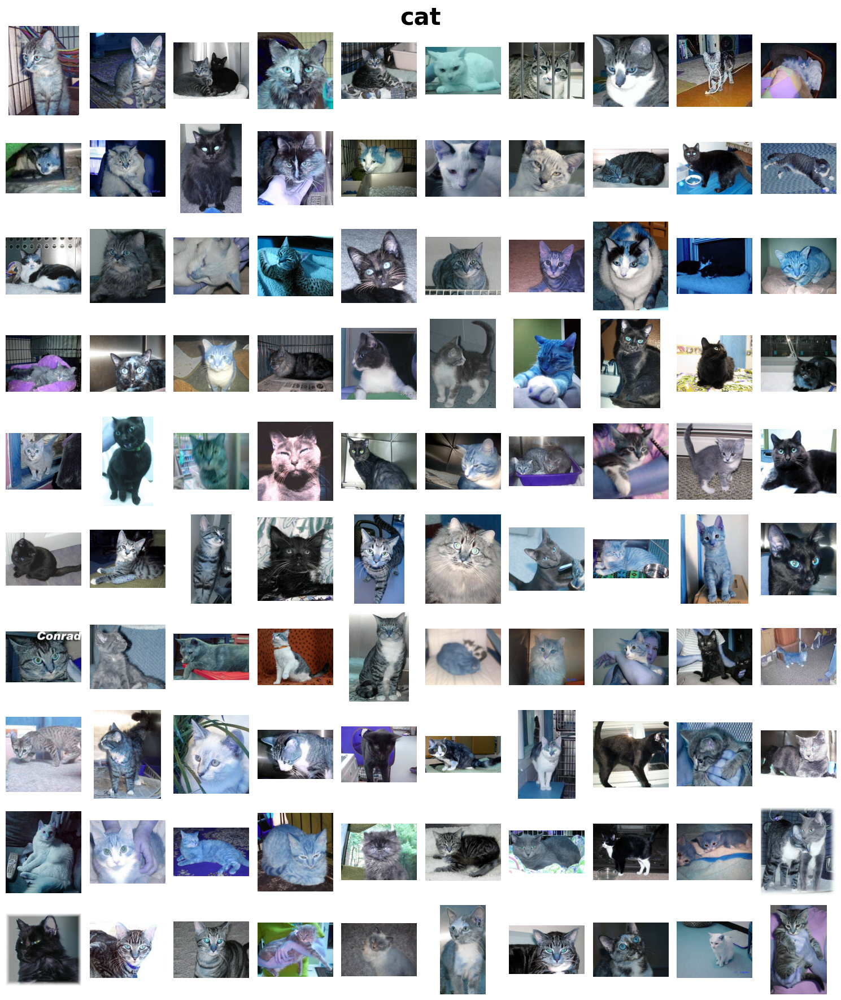

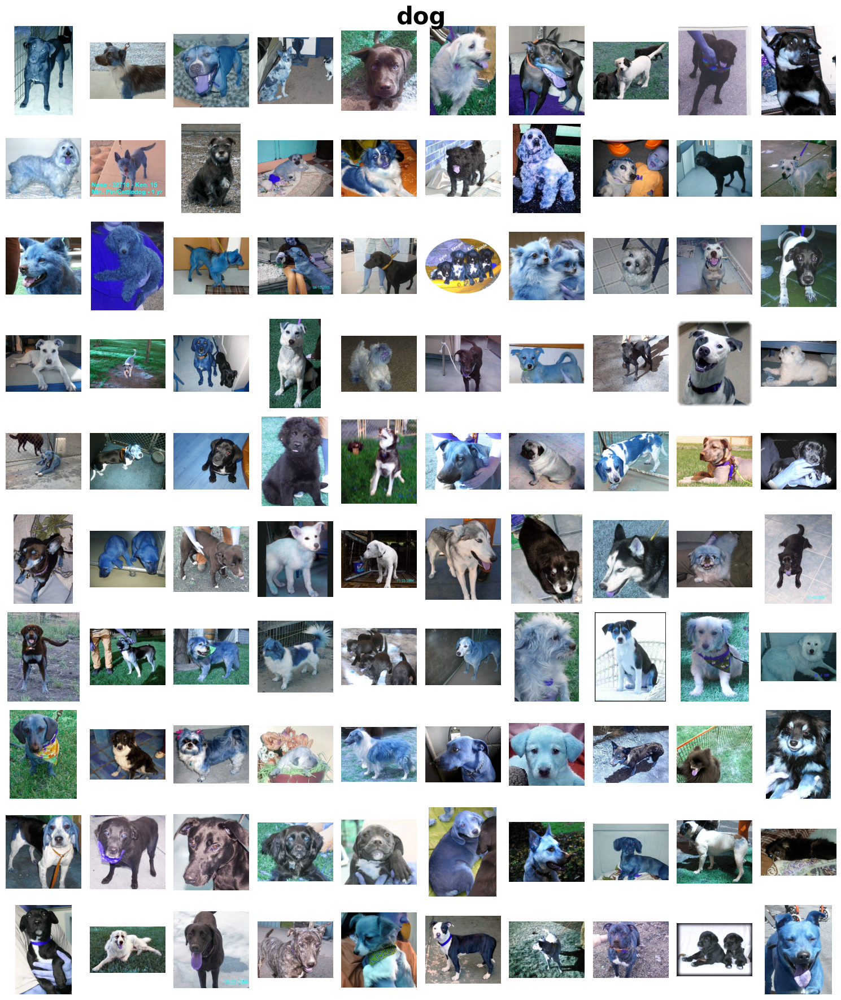

In [287]:
for classes in ['cat', 'dog'] :
    if classes == 'cat':
        images = [i for i in unequal_indices_my if i <= 1000]
    else:
        images = [i-1000 for i in unequal_indices_my if i > 1000]
        
    sqrt_num = math.sqrt(len(images))
    largest_integer_sqrt = math.floor(sqrt_num) if math.floor(sqrt_num) < 10 else 10
    
    images = images[0: largest_integer_sqrt*largest_integer_sqrt]
    
    plot_image(images, classes, largest_integer_sqrt)

### Add your conclusions

> In conclusion, although a custom model (my defined model) could demonstrate significant performance on a specific layout (MNIST dataset with 86% accuracy in lab 8), when the dataset becomes more diverse and colorful, incorporating additional variables such as species, backgrounds, angles, directions, and shapes, models that have not been carefully designed would not provide a powerful and effective solution. <br><br>
> According to the above evaluation metrics, the VGG16 model provides absolute performance better than the my defined model from all aspects (accuracy, recall, precision, f1-score, and confusion matrix), 93% - 97% versus 70%. This also explains why these models, after careful design then release, have become widely used and well-known.<br><br>
> After printing out most failed predictions of images, I can barely summarize the reasons why these images were predicted incorrectly. I am unable to find commonalities among these images. However, I do find one weird thing that is many failed predictions images that are tends towards blue with overall color display happened in both model, when I go throught all images of test dataset, these kind of thing are not usual actually, I believe it is one of reason the model failed to predict. 
